In [1]:
from pyedflib import highlevel
import pyedflib as plib
import numpy as np
import matplotlib.pyplot as plt

def read_file_signal(file_path, index):
    f = plib.EdfReader(file_path)
    signal = f.readSignal(index)
    f.close()
    return signal

def signal_labels(file_path):
    f = plib.EdfReader(file_path)
    labels = f.getSignalLabels()
    f.close()
    return labels

def combined_signal(file_list, index):
    combined_signals = []
    for file in file_list:
        temp = read_file_signal(file, index)
        combined_signals.append(temp)
    return np.concatenate(combined_signals)

edf_files_severe = [
    "c:\\Users\\anany\\Downloads\\00000066-297469[001].edf",
    "c:\\Users\\anany\\Downloads\\00000066-297469[002].edf",
    "c:\\Users\\anany\\Downloads\\00000066-297469[003].edf",
    "c:\\Users\\anany\\Downloads\\00000066-297469[004].edf",
    "c:\\Users\\anany\\Downloads\\00000066-297469[005].edf",
    "c:\\Users\\anany\\Downloads\\00000066-297469[006].edf",
    "c:\\Users\\anany\\Downloads\\00000066-297469[007].edf"
]

edf_files_normal = [
    "C:\\Users\\anany\\Downloads\\00000064-297469[001].edf",
    "C:\\Users\\anany\\Downloads\\00000064-297469[002].edf",
    "C:\\Users\\anany\\Downloads\\00000064-297469[003].edf",
    "C:\\Users\\anany\\Downloads\\00000064-297469[004].edf",
    "C:\\Users\\anany\\Downloads\\00000064-297469[005].edf",
    "C:\\Users\\anany\\Downloads\\00000064-297469[006].edf",
    "C:\\Users\\anany\\Downloads\\00000064-297469[007].edf",
    "C:\\Users\\anany\\Downloads\\00000064-297469[008].edf",
    "C:\\Users\\anany\\Downloads\\00000064-297469[009].edf"
]

edf_files_moderate = [
    "C:\\Users\\anany\\Downloads\\00000074-297469[001].edf",
    "C:\\Users\\anany\\Downloads\\00000074-297469[002].edf",
    "C:\\Users\\anany\\Downloads\\00000074-297469[003].edf",
    "C:\\Users\\anany\\Downloads\\00000074-297469[004].edf",
    "C:\\Users\\anany\\Downloads\\00000074-297469[005].edf",
    "C:\\Users\\anany\\Downloads\\00000074-297469[006].edf",
    "C:\\Users\\anany\\Downloads\\00000074-297469[007].edf",
    "C:\\Users\\anany\\Downloads\\00000074-297469[008].edf",
    "C:\\Users\\anany\\Downloads\\00000074-297469[009].edf"
]

edf_files_mild = [
    "C:\\Users\\anany\\Downloads\\00000067-297469[001].edf",
    "C:\\Users\\anany\\Downloads\\00000067-297469[002].edf",
    "C:\\Users\\anany\\Downloads\\00000067-297469[003].edf",
    "C:\\Users\\anany\\Downloads\\00000067-297469[004].edf",
    "C:\\Users\\anany\\Downloads\\00000067-297469[005].edf",
    "C:\\Users\\anany\\Downloads\\00000067-297469[006].edf",
    "C:\\Users\\anany\\Downloads\\00000067-297469[007].edf",
    "C:\\Users\\anany\\Downloads\\00000067-297469[008].edf",
    "C:\\Users\\anany\\Downloads\\00000067-297469[009].edf",
    "C:\\Users\\anany\\Downloads\\00000067-297469[010].edf",
    "C:\\Users\\anany\\Downloads\\00000067-297469[011].edf",
]

labels = signal_labels(edf_files_normal[0])
print(labels)
labels[16] = "Flow patient 1"
labels[17] = "Flow patient 2"
labels[23] = "Flow patient 3"
cv_dict = {}

['EEG F3-A2', 'EEG F4-A1', 'EEG A1-A2', 'EEG C3-A2', 'EEG C4-A1', 'EEG O1-A2', 'EEG O2-A1', 'EOG LOC-A2', 'EOG ROC-A2', 'EMG Chin', 'Leg 1', 'Leg 2', 'ECG I', 'RR', 'ECG II', 'Snore', 'Flow Patient', 'Flow Patient', 'Effort THO', 'Effort ABD', 'SpO2', 'Pleth', 'Body', 'Flow Patient', 'xPAP CPAP', 'xPAP IPAP', 'xPAP EPAP', 'Leak Total', 'PulseRate', 'PressCheck', 'ECG IIHF', 'Technical']


In [30]:
import statistics as stat
import matplotlib.pyplot as plt

def plot_signal(label, signal):
    plt.figure(figsize=(20, 10))
    plt.plot(signal)
    plt.title(f"{label} signal")
    plt.xlabel("time")
    plt.ylabel("amplitude")
    # plt.ylim(-300, 300)
    plt.show()

def thresholding(signal, threshold, replace_with):
    mean = signal.mean()
    std = stat.stdev(signal)
    lower_limit = mean - threshold * std
    upper_limit = mean + threshold * std
    filtered_signal = np.where((signal >= lower_limit) & (signal <= upper_limit), signal, replace_with)
    return filtered_signal
    

-71.12870362628134


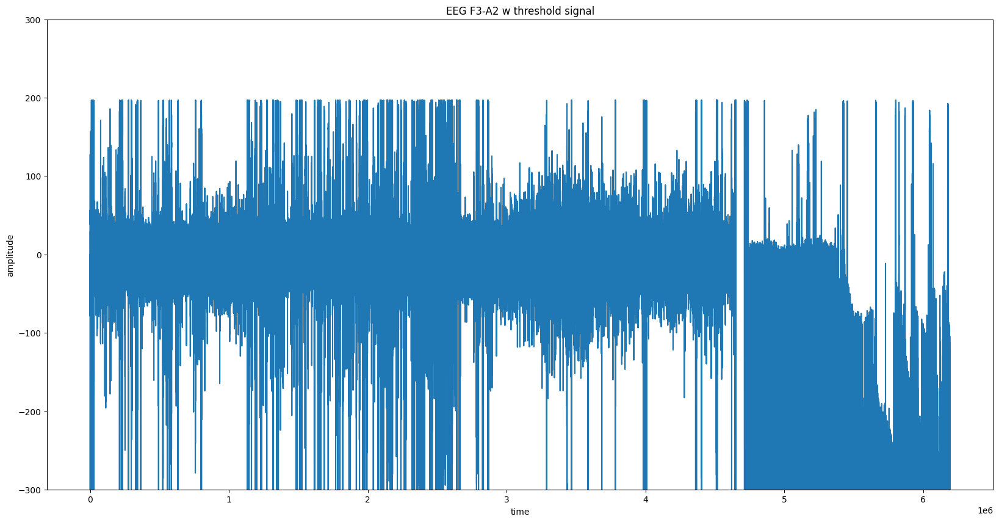

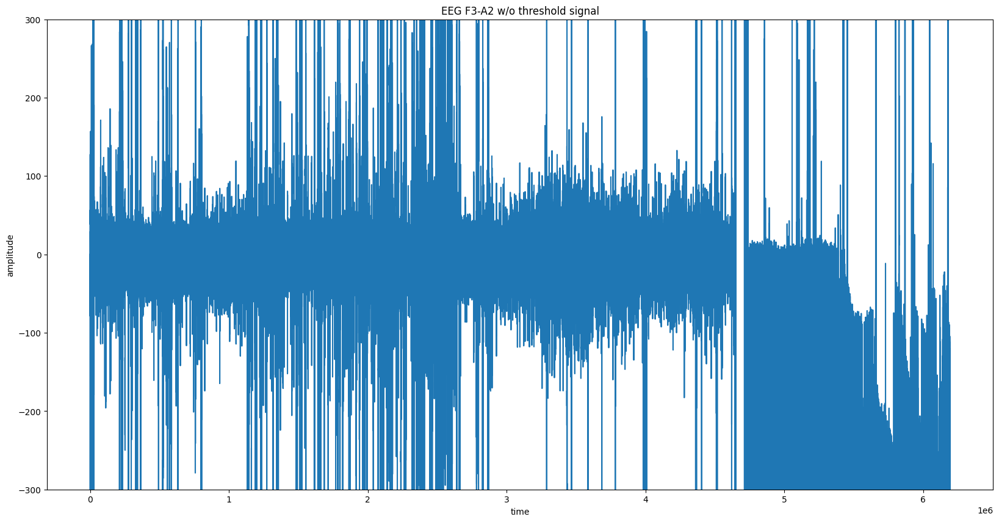

In [23]:
combined = combined_signal(edf_files_normal, 0)
print(combined.mean())
threholded_signal = thresholding(combined, 2)
plot_signal(f"{labels[0]} w threshold", threholded_signal)
plot_signal(f"{labels[0]} w/o threshold", combined)

In [32]:
print(labels.index("Flow patient 3"))
print(labels.index("Leak Total"))

23
27


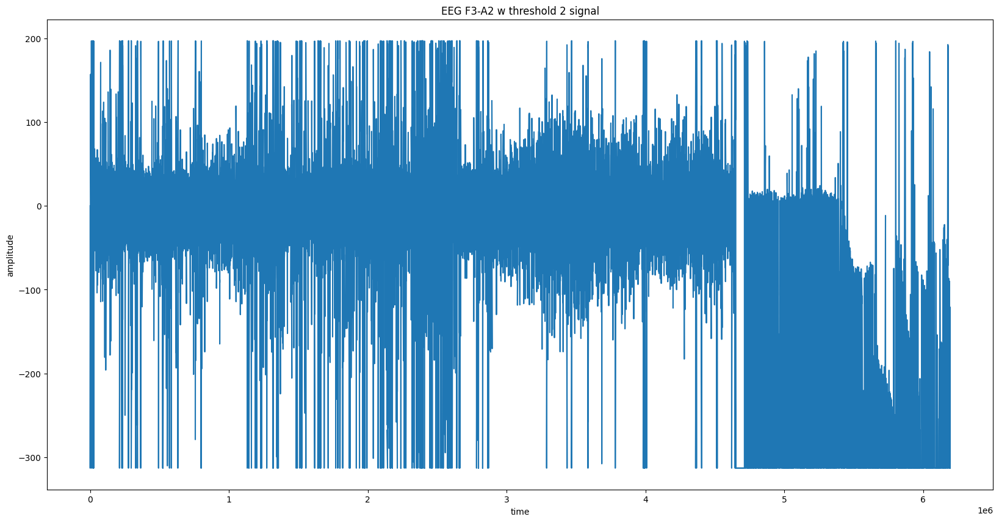

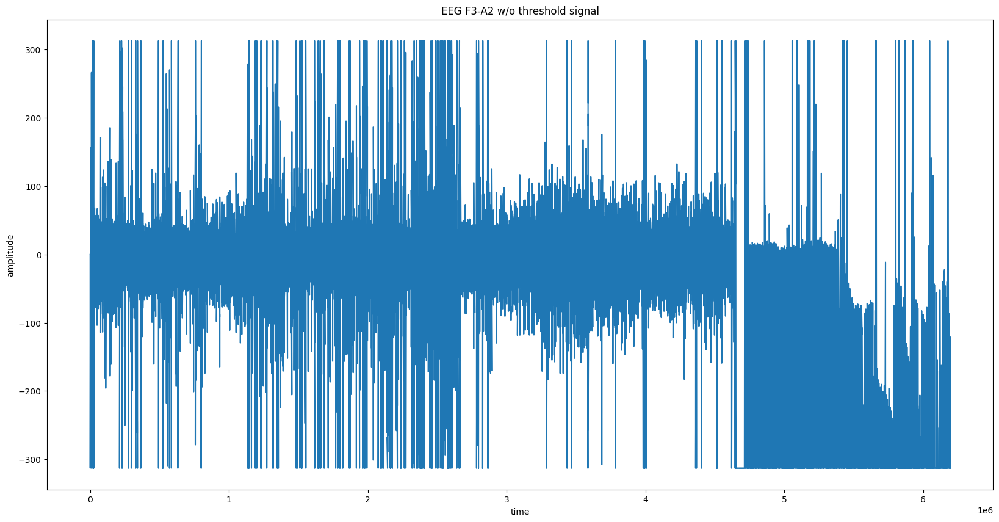

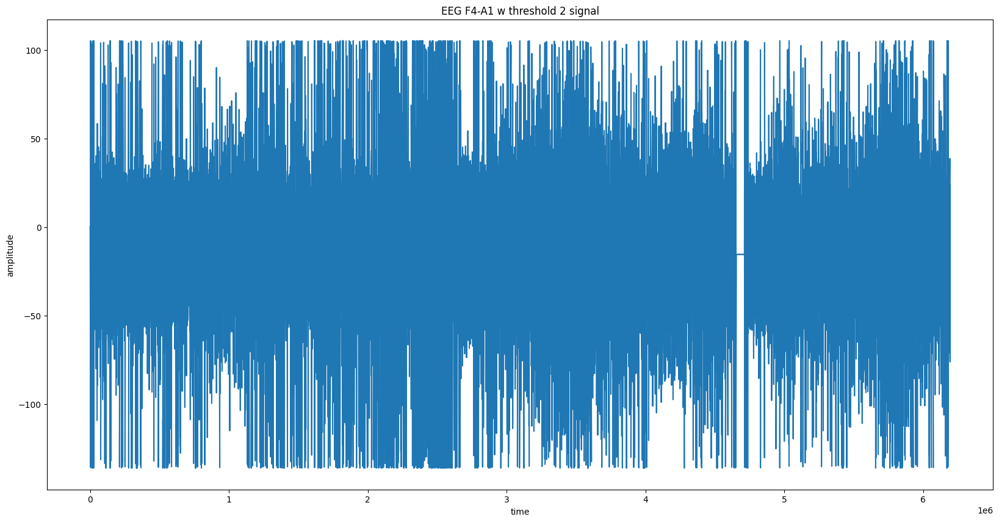

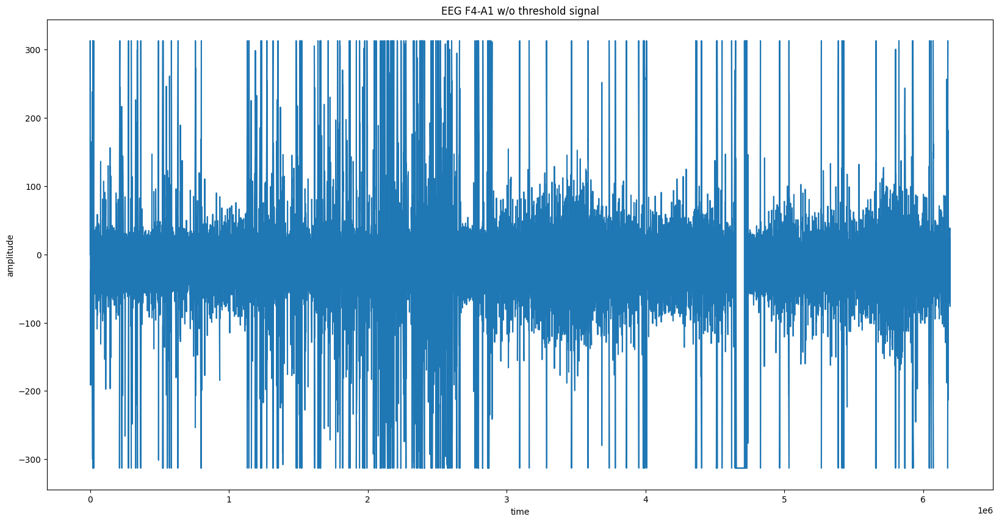

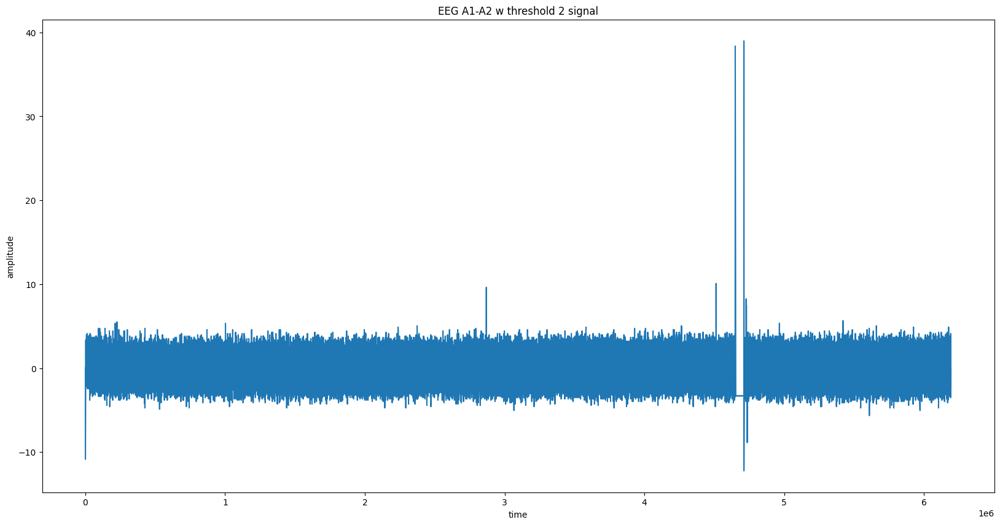

...

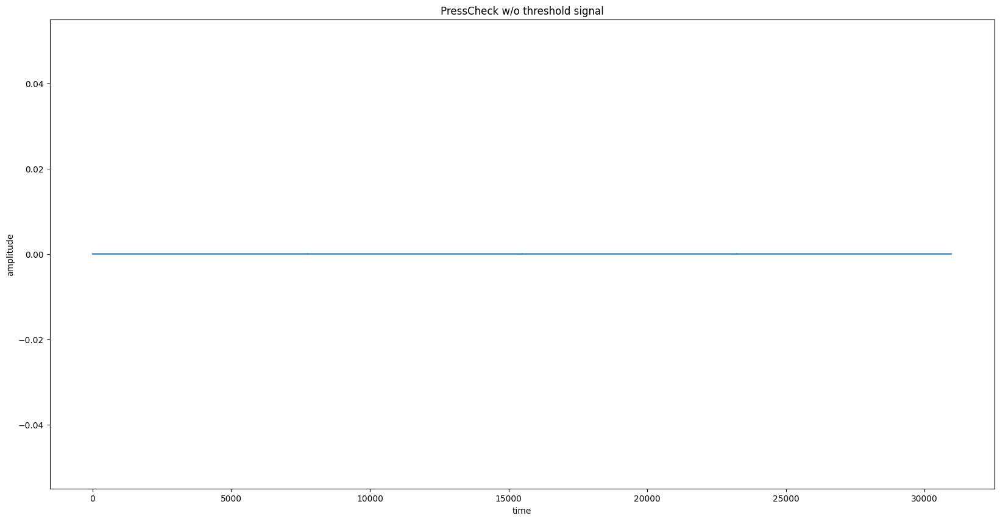

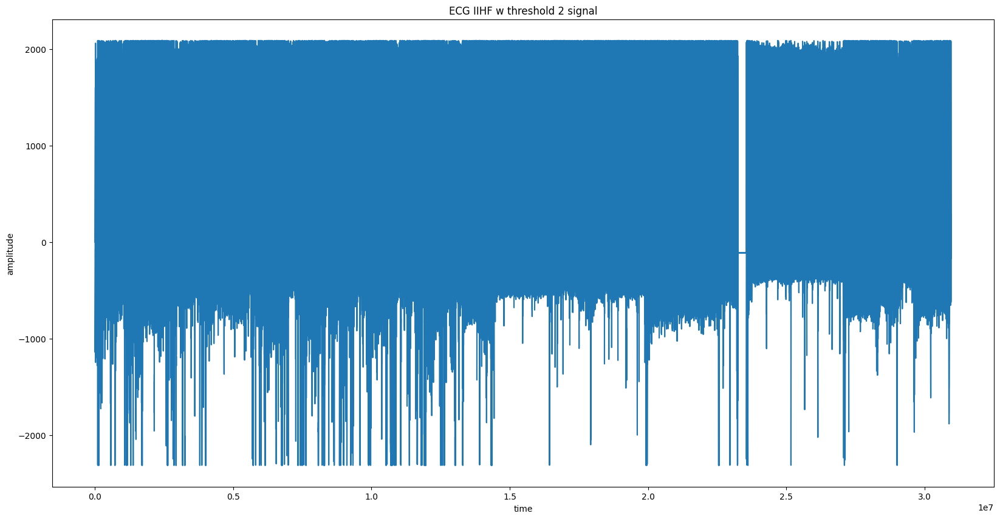

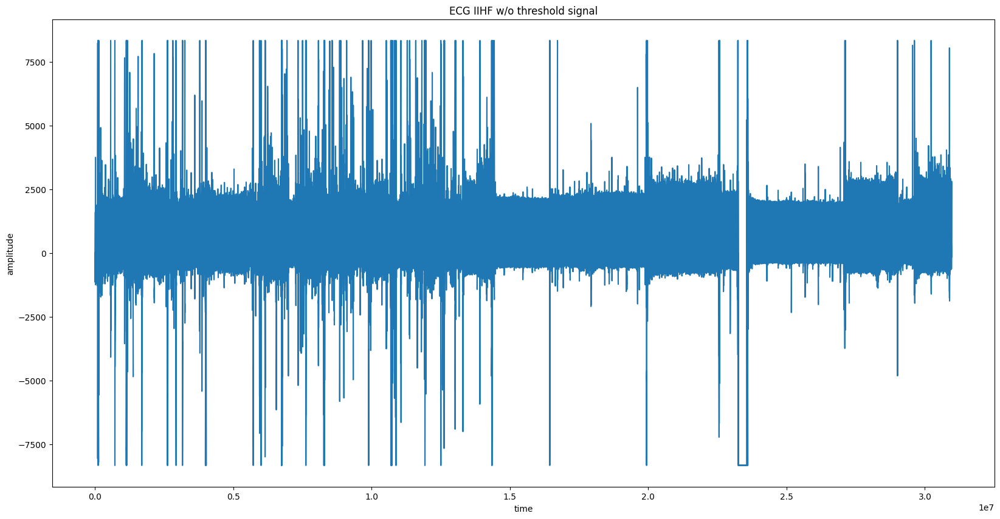

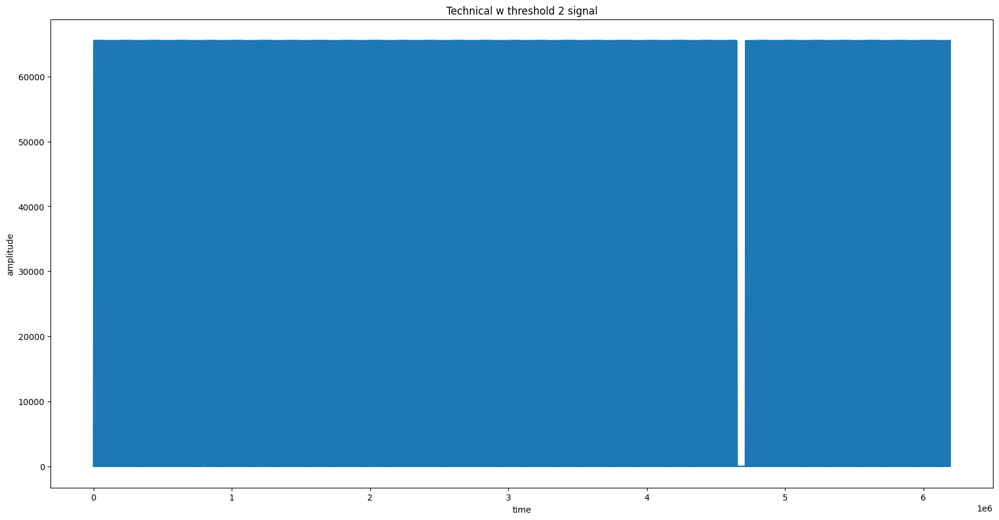

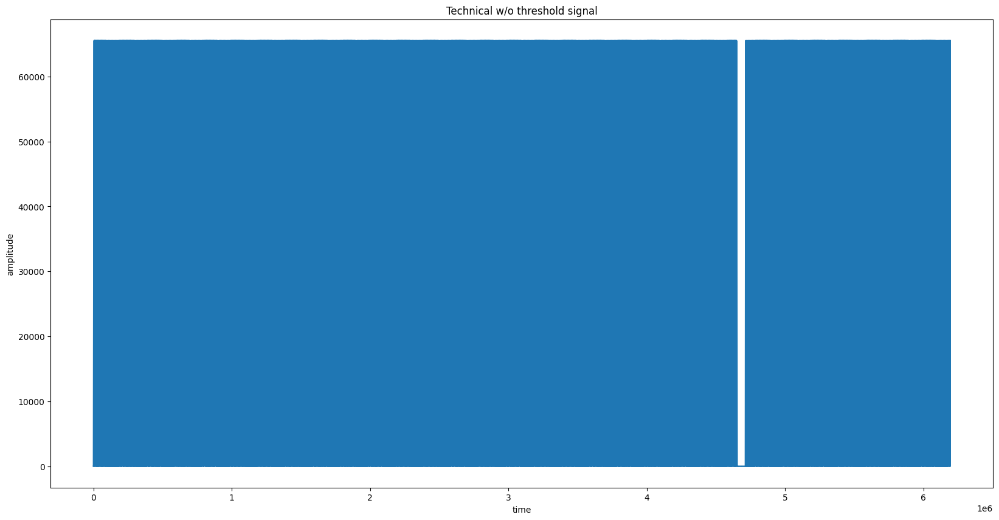

In [35]:
normal_denoised_signals = []

plt.rcParams['agg.path.chunksize'] = 10000  # Increase the chunksize
plt.rcParams['path.simplify_threshold'] = 1.0  # Increase the simplification threshold


for i in range(32):
    combined = combined_signal(edf_files_normal, i)
    if i in [23, 37]:
        threholded_signal = thresholding(combined, 2, 0)
    threholded_signal = thresholding(combined, 2, combined.mean())
    normal_denoised_signals.append(threholded_signal)
    plot_signal(f"{labels[i]} w threshold 2", threholded_signal)
    plot_signal(f"{labels[i]} w/o threshold", combined)

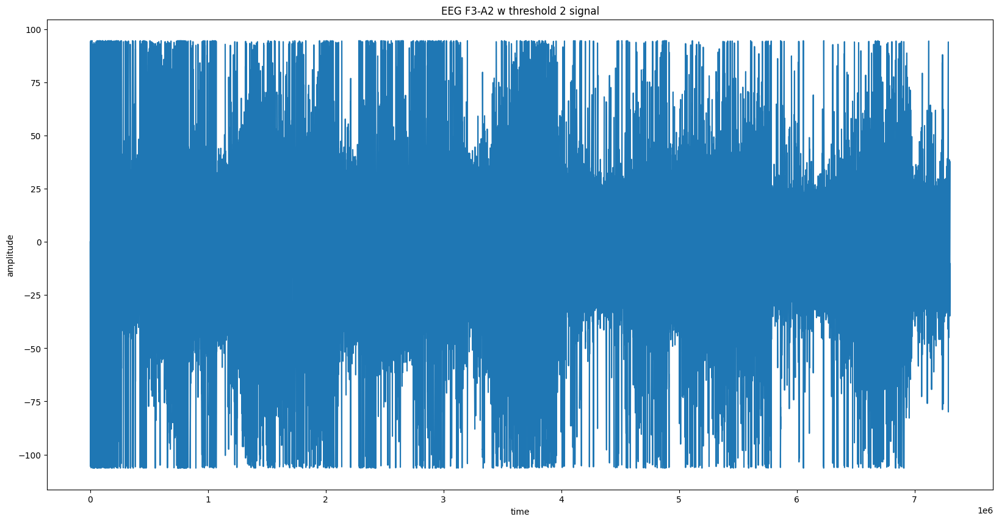

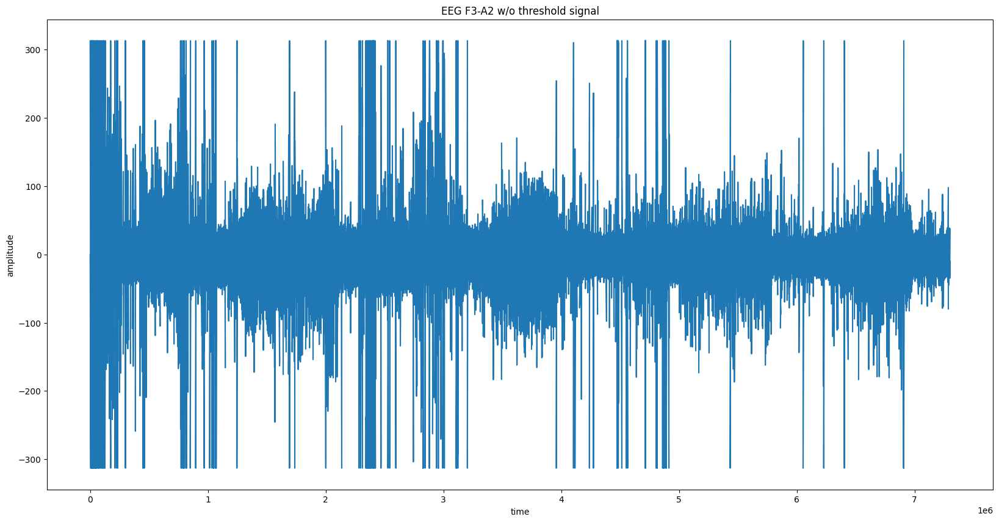

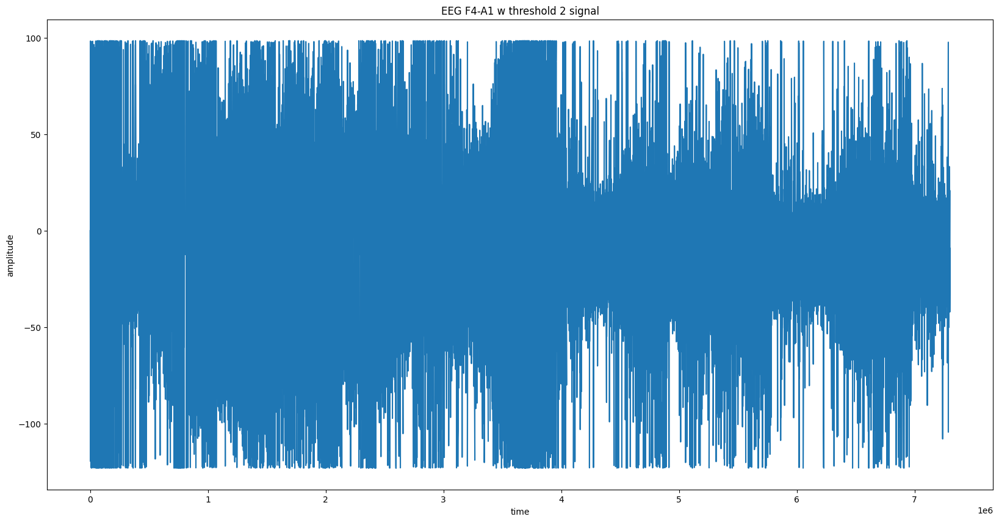

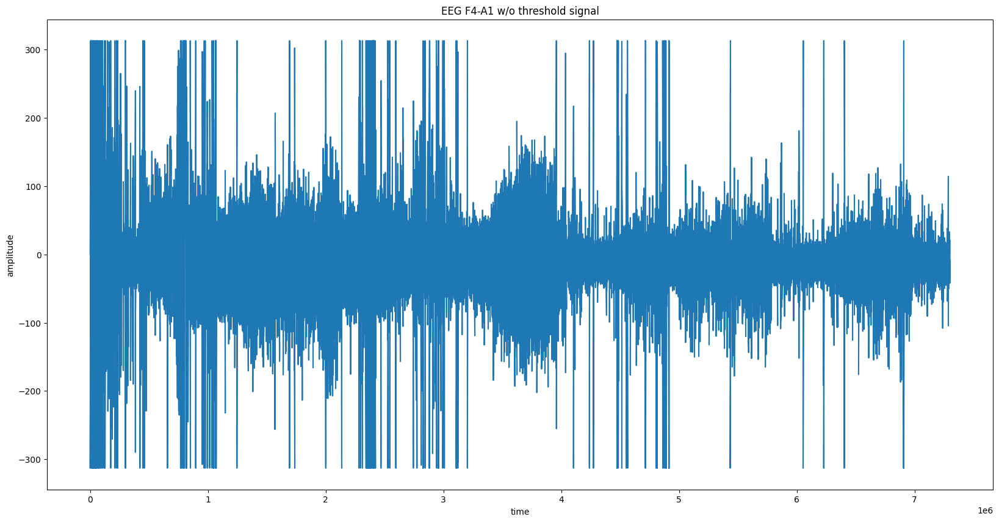

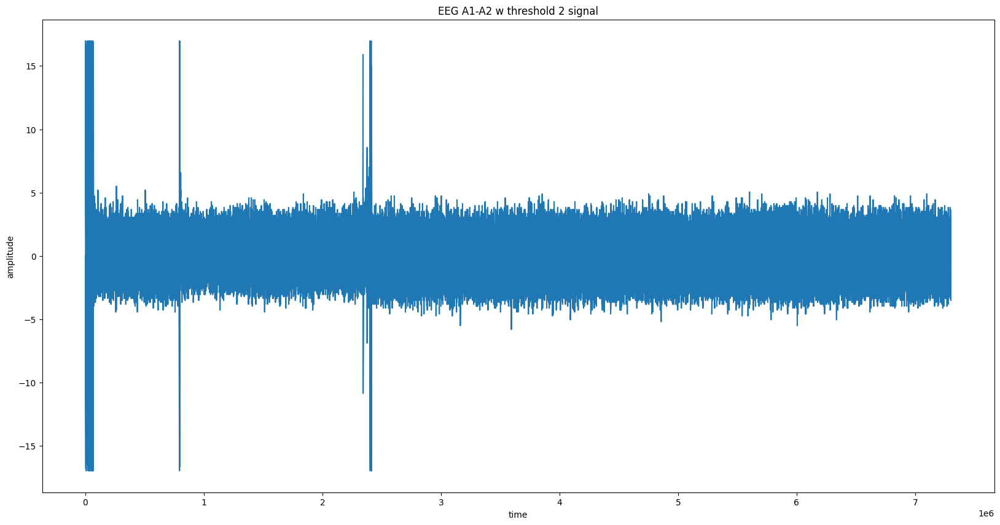

...

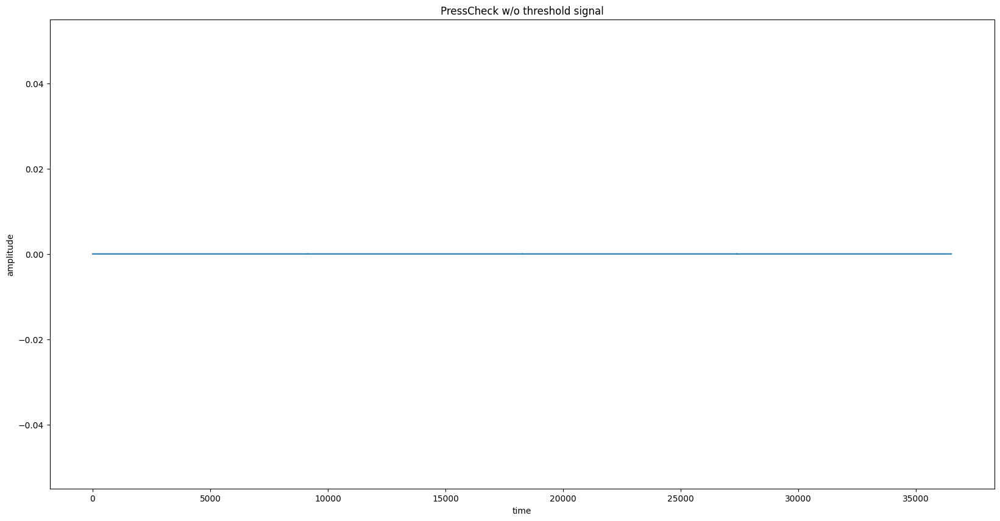

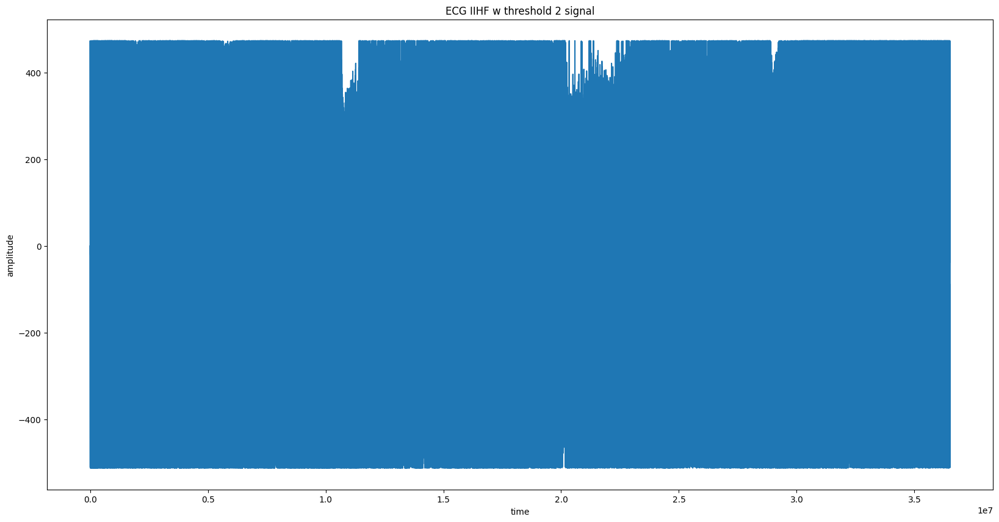

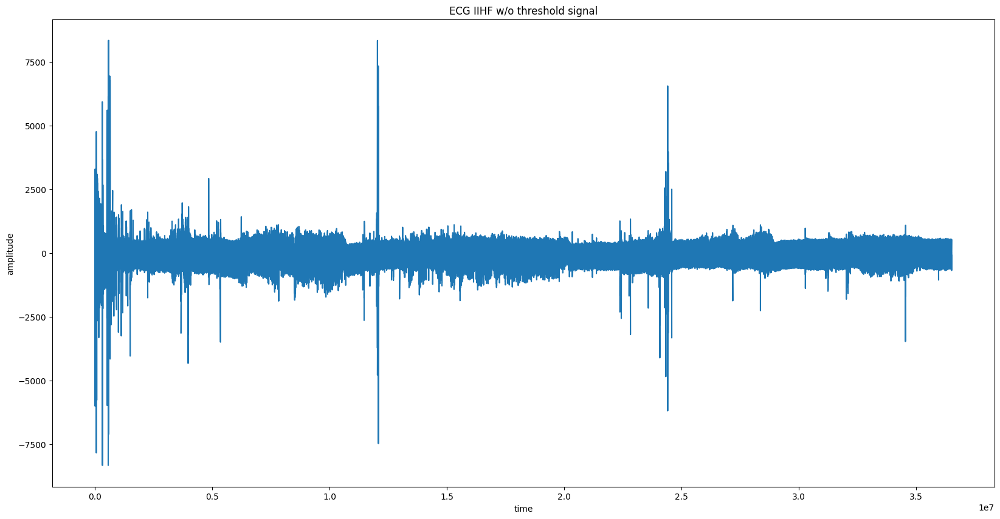

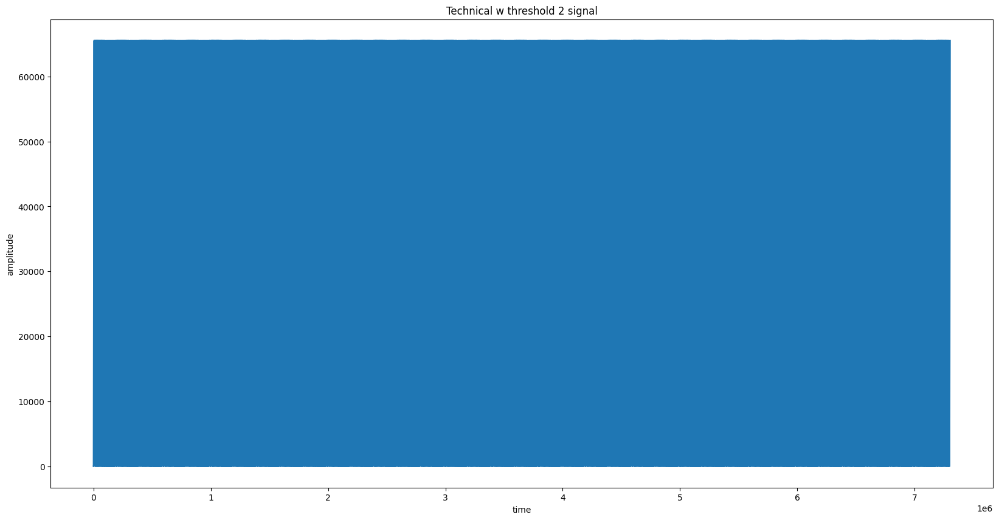

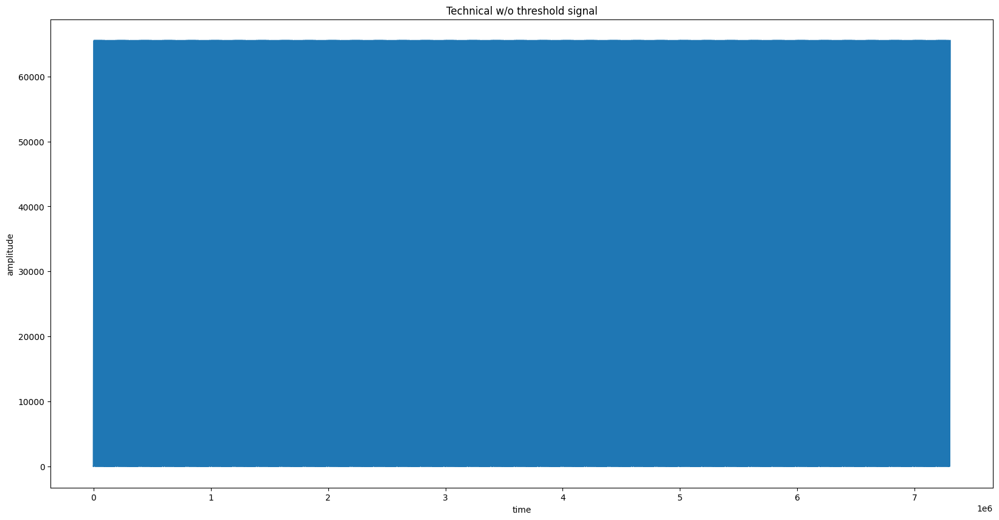

In [36]:
mild_denoised_signals = []

plt.rcParams['agg.path.chunksize'] = 10000  # Increase the chunksize
plt.rcParams['path.simplify_threshold'] = 1.0  # Increase the simplification threshold


for i in range(32):
    combined = combined_signal(edf_files_mild, i)
    # if i in [23, 37]:
    #     threholded_signal = thresholding(combined, 2, 0)
    threholded_signal = thresholding(combined, 2, combined.mean())
    mild_denoised_signals.append(threholded_signal)
    plot_signal(f"{labels[i]} w threshold 2", threholded_signal)
    plot_signal(f"{labels[i]} w/o threshold", combined)

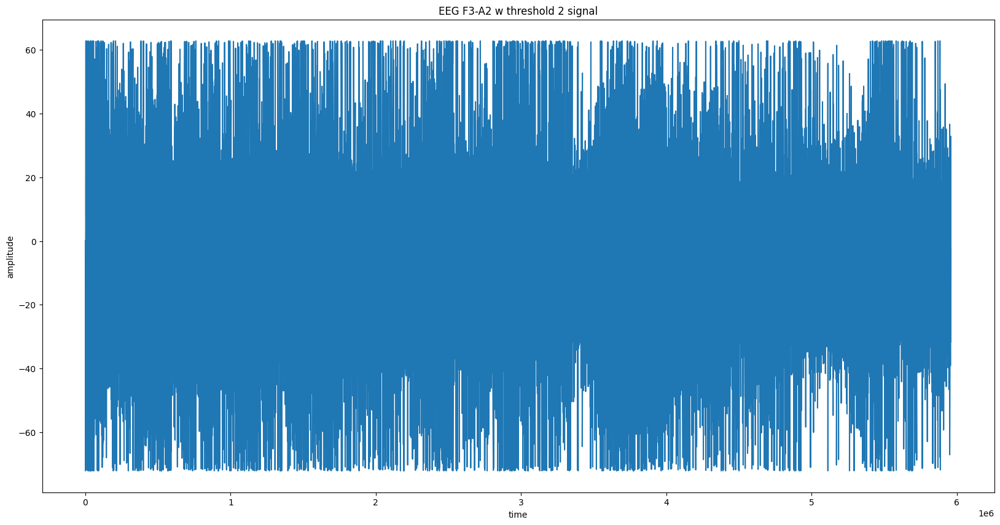

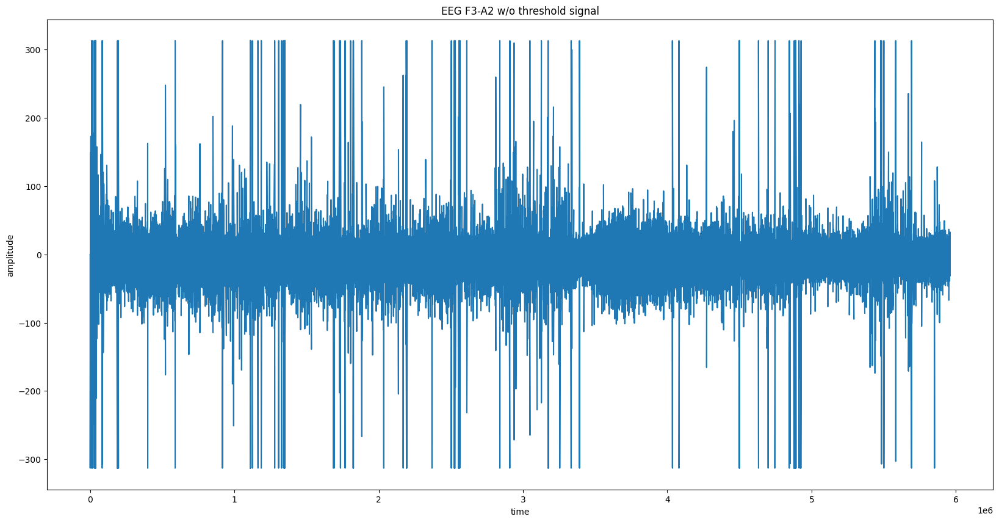

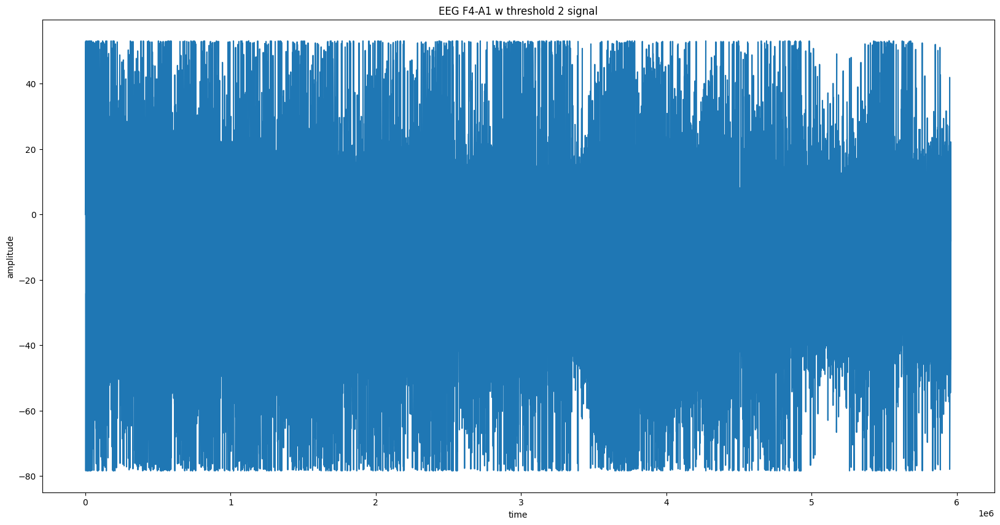

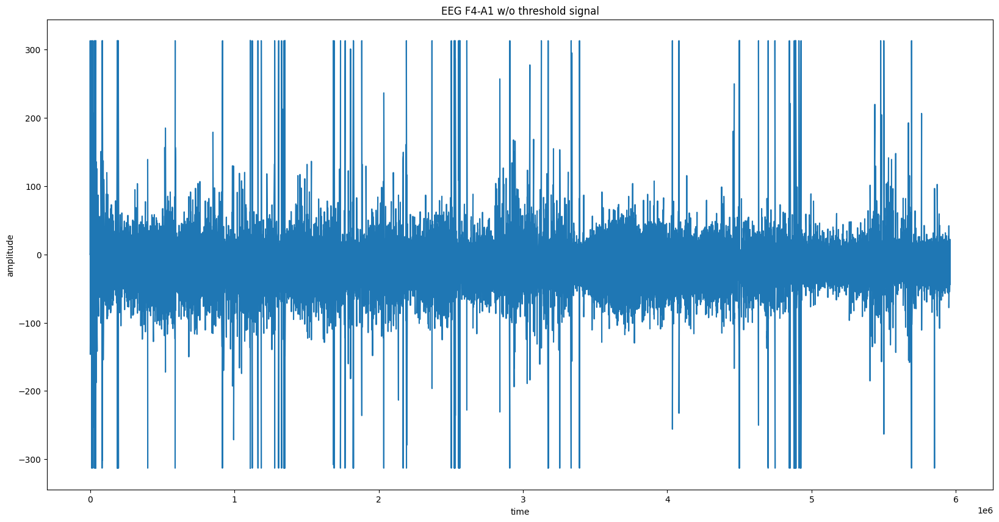

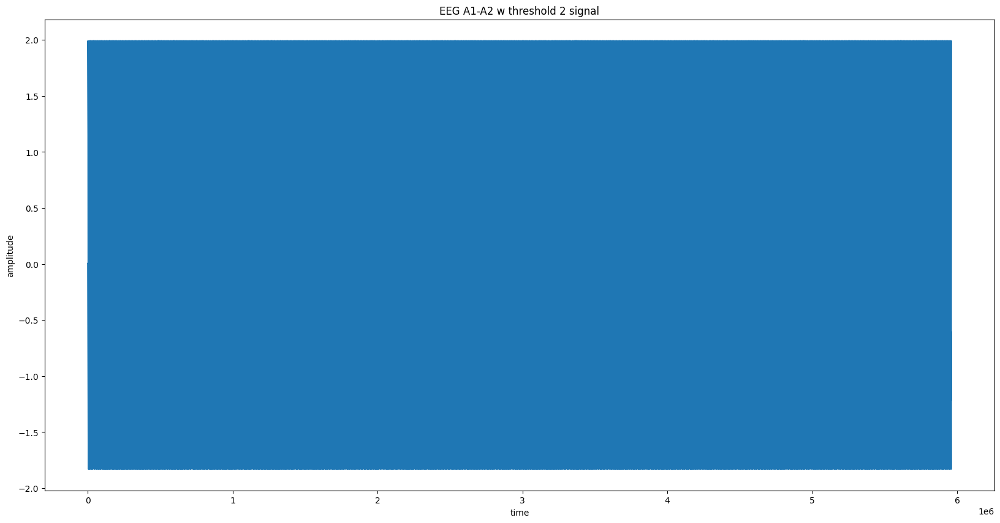

...

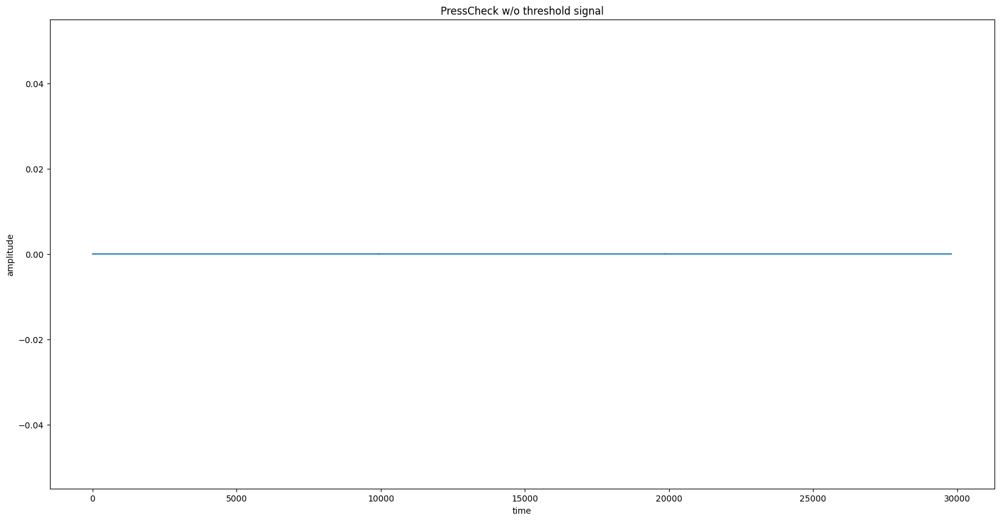

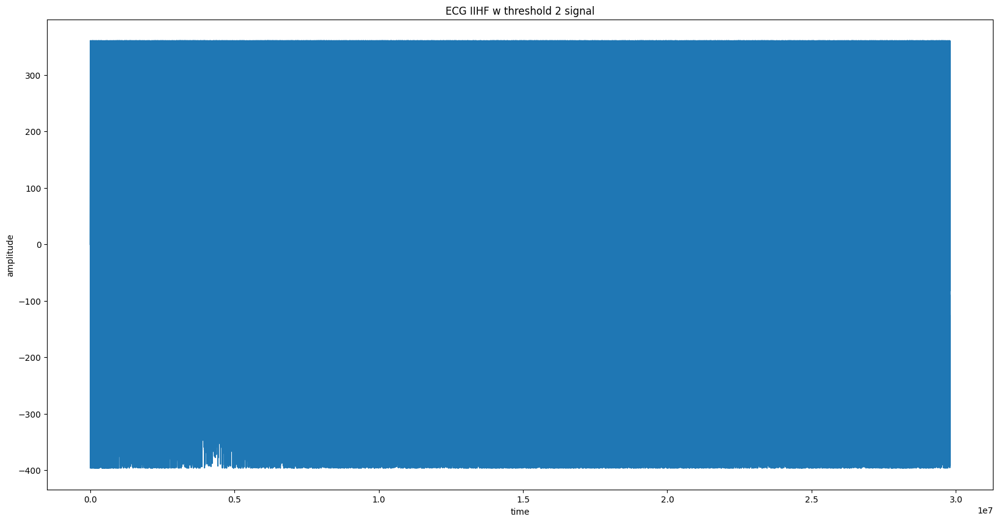

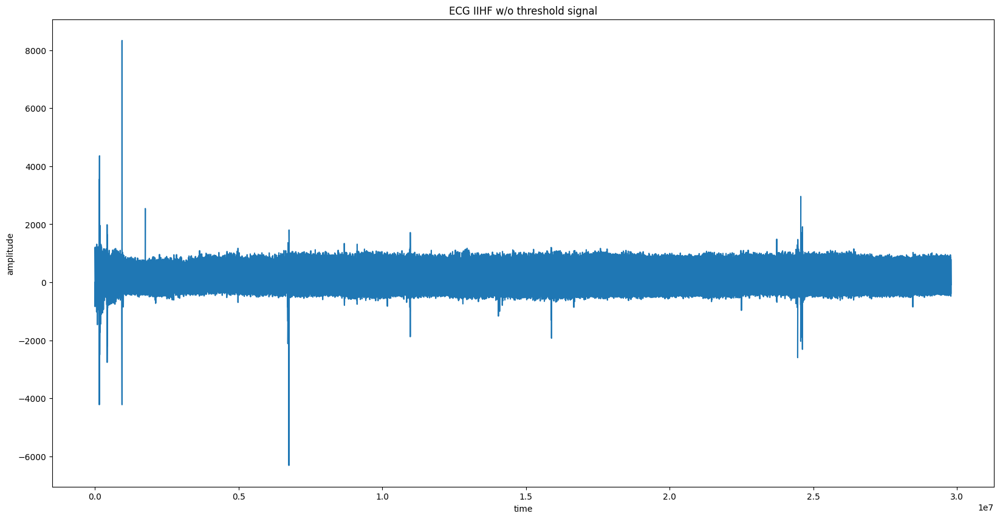

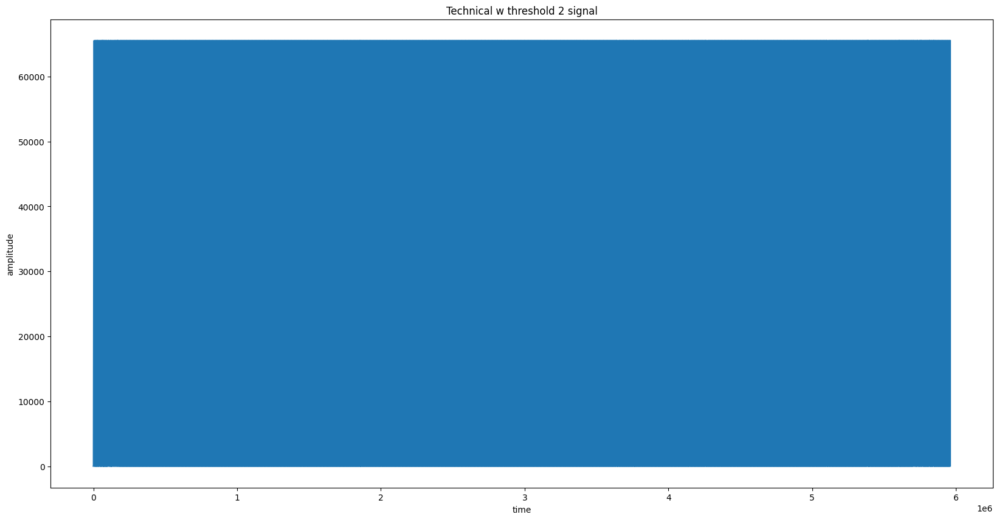

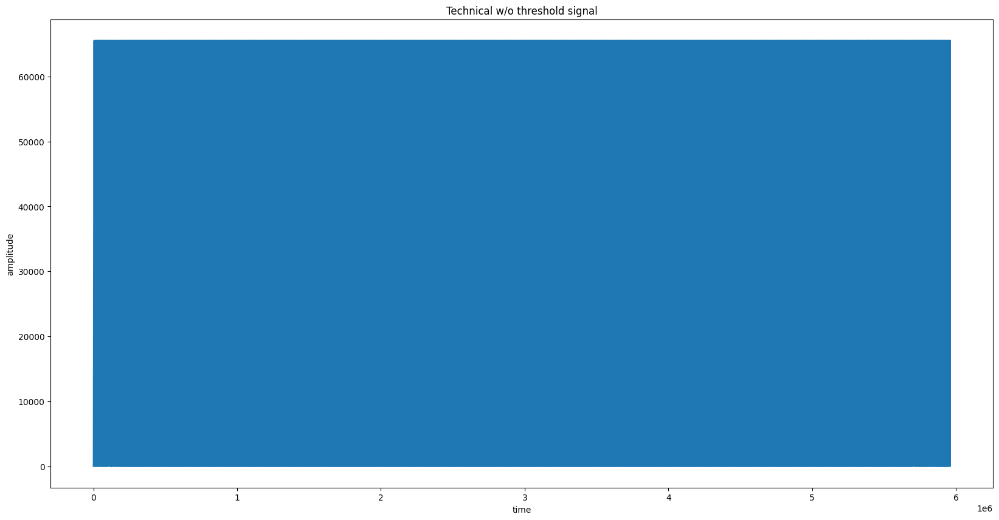

In [37]:
moderate_denoised_signals = []

plt.rcParams['agg.path.chunksize'] = 10000  # Increase the chunksize
plt.rcParams['path.simplify_threshold'] = 1.0  # Increase the simplification threshold


for i in range(32):
    combined = combined_signal(edf_files_moderate, i)
    # if i in [23, 37]:
    #     threholded_signal = thresholding(combined, 2, 0)
    threholded_signal = thresholding(combined, 2, combined.mean())
    moderate_denoised_signals.append(threholded_signal)
    plot_signal(f"{labels[i]} w threshold 2", threholded_signal)
    plot_signal(f"{labels[i]} w/o threshold", combined)

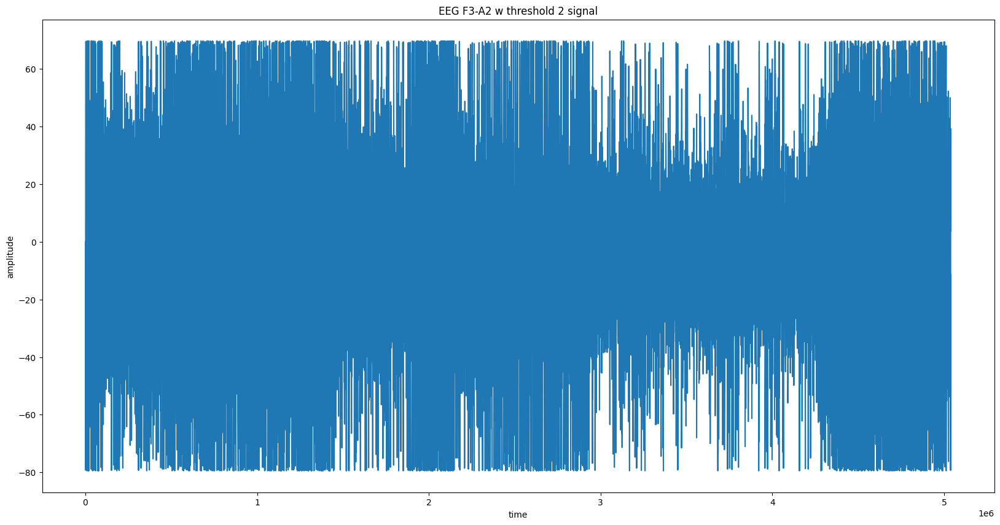

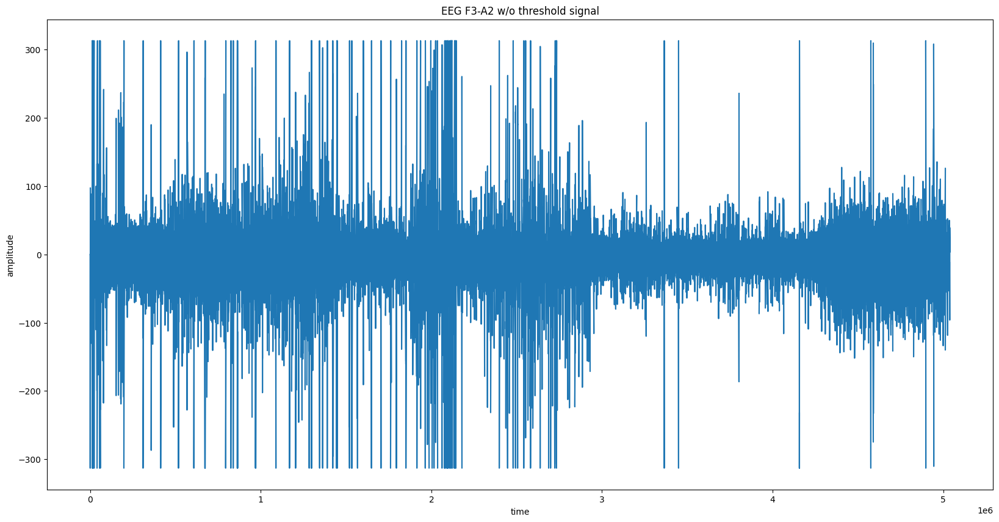

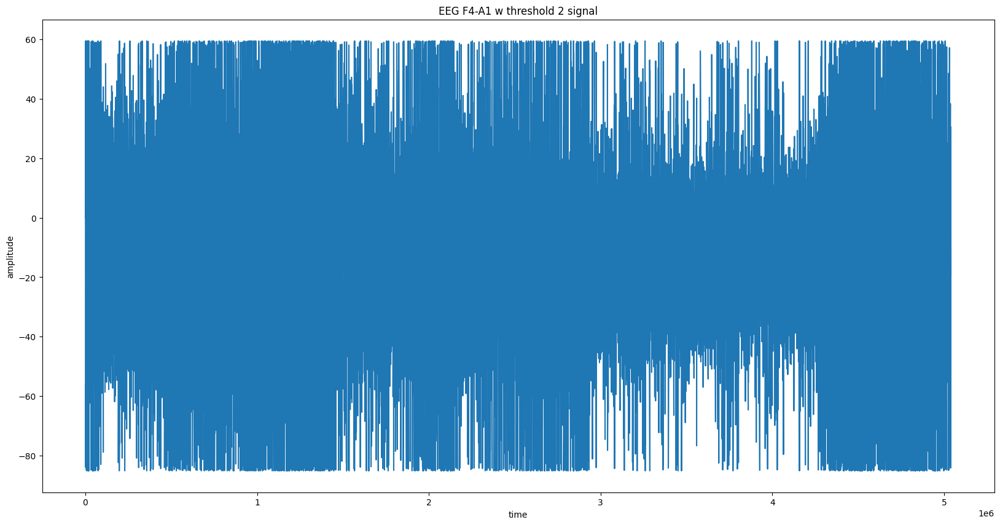

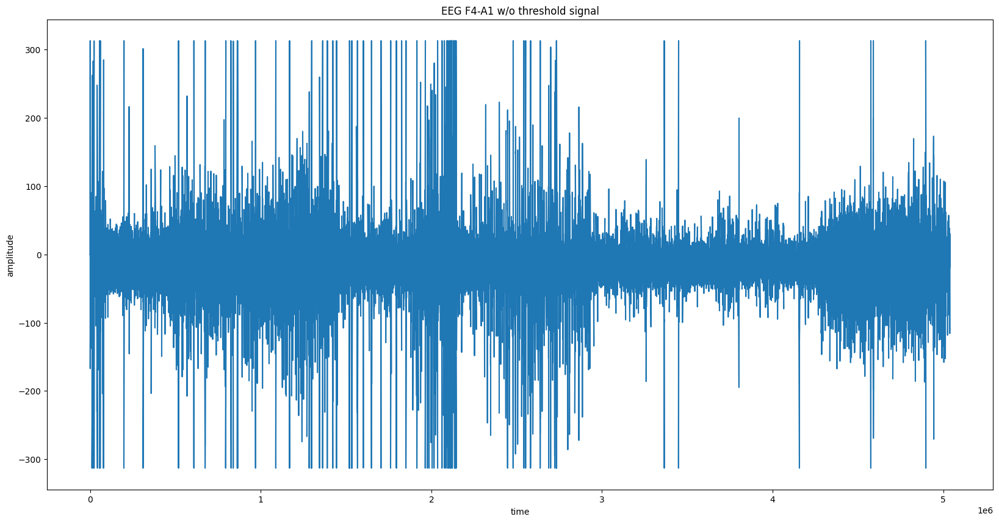

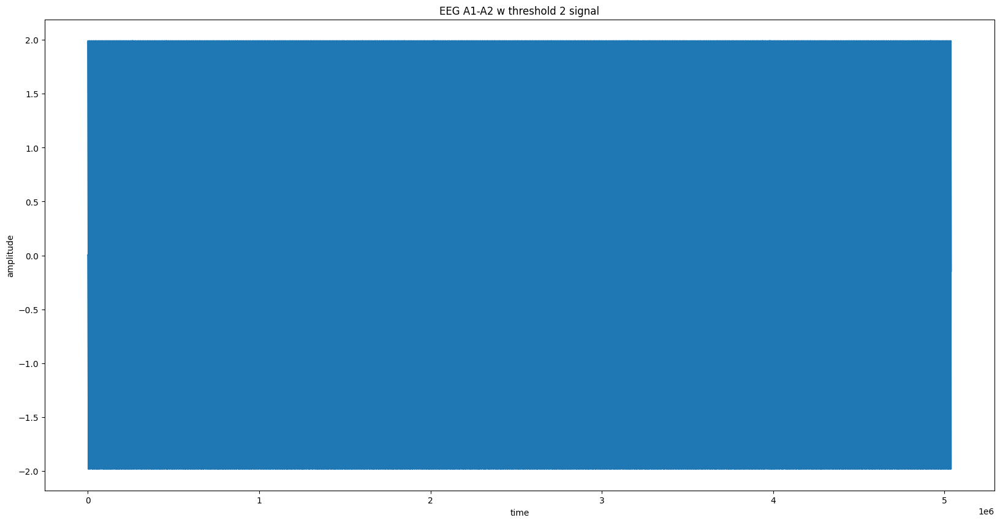

...

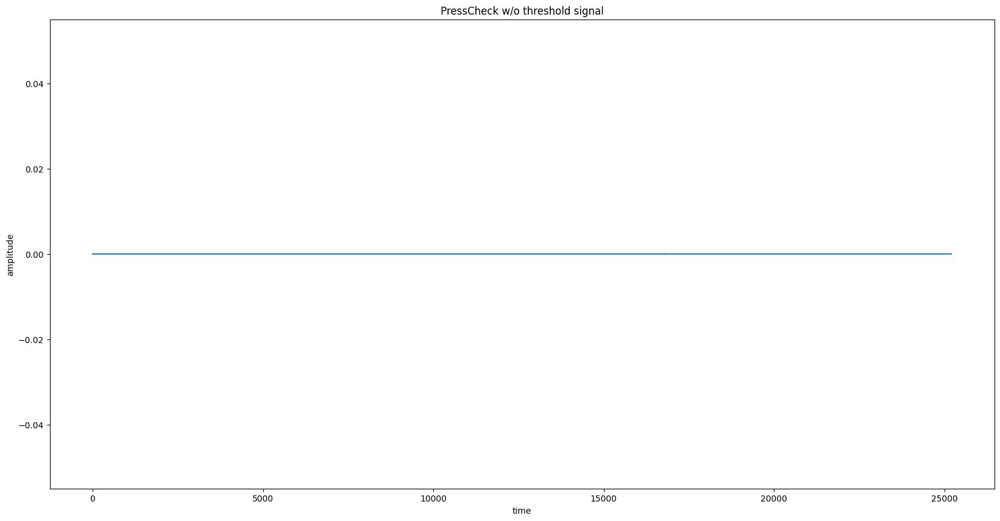

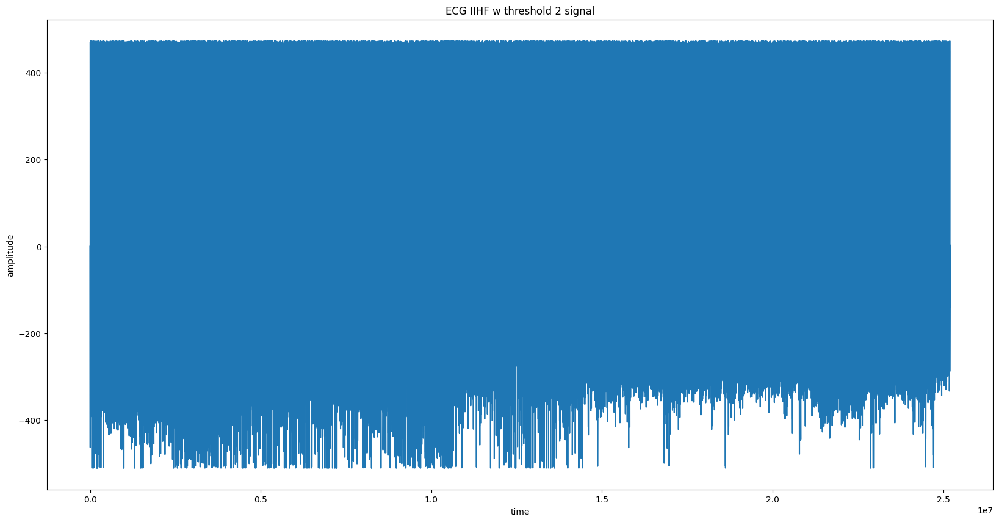

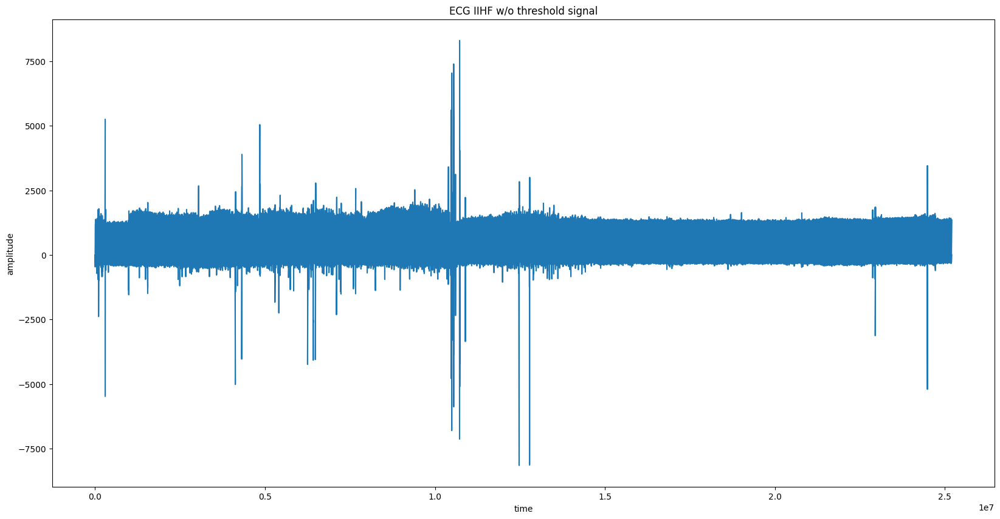

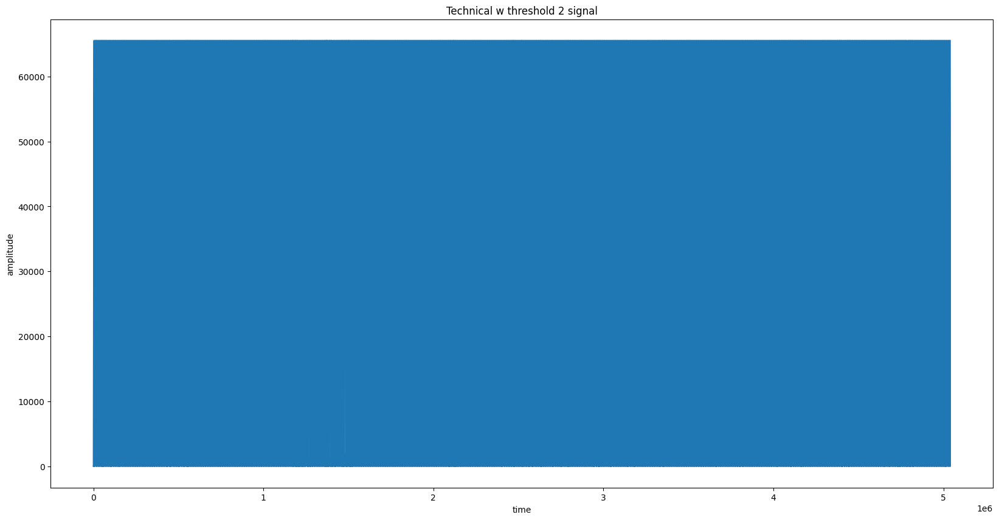

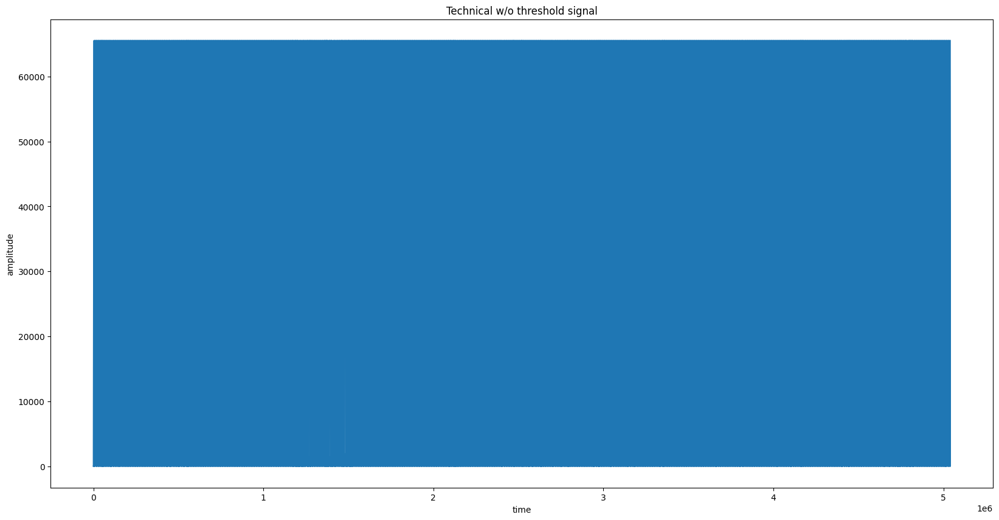

In [38]:
severe_denoised_signals = []

plt.rcParams['agg.path.chunksize'] = 10000  # Increase the chunksize
plt.rcParams['path.simplify_threshold'] = 1.0  # Increase the simplification threshold


for i in range(32):
    combined = combined_signal(edf_files_severe, i)
    # if i in [23, 37]:
    #     threholded_signal = thresholding(combined, 2, 0)
    threholded_signal = thresholding(combined, 2, combined.mean())
    severe_denoised_signals.append(threholded_signal)
    plot_signal(f"{labels[i]} w threshold 2", threholded_signal)
    plot_signal(f"{labels[i]} w/o threshold", combined)

In [40]:
print(severe_denoised_signals[-1].mean())

30812.591493849206


In [41]:
import statistics as stats

def find_cv(channel):
    mean = channel.mean()
    var = stats.variance(channel)
    if mean == 0:
        return 'nil'
    return var/mean

In [45]:
combined_cv_dict = {}

for i in range(32):
    if i in [22, 29, 31]:
        continue
    combined_cv_dict[labels[i]] = []
    cv_1 = find_cv(normal_denoised_signals[i])
    cv_2 = find_cv(mild_denoised_signals[i])
    cv_3 = find_cv(moderate_denoised_signals[i])
    cv_4 = find_cv(severe_denoised_signals[i])
    print(cv_1, cv_2, cv_3, cv_4)
    combined_cv_dict[labels[i]].append(cv_1)
    combined_cv_dict[labels[i]].append(cv_2)
    combined_cv_dict[labels[i]].append(cv_3)
    combined_cv_dict[labels[i]].append(cv_4)

print(combined_cv_dict)

-222.24478139590155 -79.66995506267004 -43.25889943026674 -70.81955565304601
-44.750436199212054 -45.90906071888898 -17.35054424105187 -27.163808718904704
-14.649956202158169 -95.13631322915576 8.848678707248764 22.342155082923163
-87.57396424531424 -39.96833621288949 -20.869323960468908 -41.73468766869981
55.71167005815262 30.018018616748005 17.632928759613947 39.19074417187527
2.15663424423403 0.23298140736627856 1.3206825555942956 0.19370035856266066
1.749134499557597 0.10961434365747179 0.7141501837990702 0.09046107431110083
46.53822246557445 23.67025013906182 14.237381564198294 33.27244734753873
-121.35231029136257 -83.60784742043583 -43.531829665357776 -91.95984675079126
-260.8189270434705 -158.29861826375696 -138.48287100333877 -495.8656586623444
-148.60361615915377 -206.1689686296542 -149.536539089855 -181.2308002742963
-127.61280958314816 -206.9900524879505 -188.50703371089605 -178.82396608226188
-1243.9633832543334 -460.95260270917476 -117.54116734742985 -94.28944864451168
1.

In [47]:
channel_variability = {}

for channel, vmr_values in combined_cv_dict.items():
    # abs_vmr_values = [abs(value) for value in vmr_values]
    # variability = max(abs_vmr_values) - min(abs_vmr_values)
    # channel_variability[channel] = variability
    abs_vmr_values = []
    for value in vmr_values:
        if value == 'nil':
            value = 0
        
        abs_vmr_values.append(abs(float(value)))
    
        variability = max(abs_vmr_values) - min(abs_vmr_values)
        channel_variability[channel] = variability

sorted_channels = sorted(channel_variability, key=channel_variability.get, reverse=True)

top_10_channels = sorted_channels[:32]
print(sorted_channels)
print(channel_variability['Snore'])
print("Top 10 channels based on variability:")
for channel in top_10_channels:
    print(f"{channel}: {channel_variability[channel]}")

['ECG II', 'ECG IIHF', 'Pleth', 'Flow patient 1', 'ECG I', 'Effort THO', 'EMG Chin', 'Flow patient 2', 'Flow patient 3', 'EEG F3-A2', 'Effort ABD', 'EEG A1-A2', 'Leg 2', 'EOG ROC-A2', 'Snore', 'EEG C3-A2', 'Leg 1', 'EEG C4-A1', 'Leak Total', 'EOG LOC-A2', 'EEG F4-A1', 'xPAP CPAP', 'xPAP IPAP', 'xPAP EPAP', 'EEG O1-A2', 'EEG O2-A1', 'PulseRate', 'RR', 'SpO2']
69.02706917092397
Top 10 channels based on variability:
ECG II: 2499.5573949269524
ECG IIHF: 2400.02115907236
Pleth: 1659.4622845738559
Flow patient 1: 1168.5264766191992
ECG I: 1149.6739346098218
Effort THO: 595.2913532753801
EMG Chin: 357.38278765900566
Flow patient 2: 342.4399182735728
Flow patient 3: 337.0012848930209
EEG F3-A2: 178.9858819656348
Effort ABD: 138.19790850630432
EEG A1-A2: 86.287634521907
Leg 2: 79.37724290480233
EOG ROC-A2: 77.8204806260048
Snore: 69.02706917092397
EEG C3-A2: 66.70464028484534
Leg 1: 57.565352470500414
EEG C4-A1: 38.078741298538674
Leak Total: 34.076145293444654
EOG LOC-A2: 32.300840901376155
EE

In [48]:
print(channel_variability)

{'EEG F3-A2': 178.9858819656348, 'EEG F4-A1': 28.55851647783711, 'EEG A1-A2': 86.287634521907, 'EEG C3-A2': 66.70464028484534, 'EEG C4-A1': 38.078741298538674, 'EEG O1-A2': 1.9629338856713692, 'EEG O2-A1': 1.6586734252464963, 'EOG LOC-A2': 32.300840901376155, 'EOG ROC-A2': 77.8204806260048, 'EMG Chin': 357.38278765900566, 'Leg 1': 57.565352470500414, 'Leg 2': 79.37724290480233, 'ECG I': 1149.6739346098218, 'RR': 0.5686322754705704, 'ECG II': 2499.5573949269524, 'Snore': 69.02706917092397, 'Flow patient 1': 1168.5264766191992, 'Flow patient 2': 342.4399182735728, 'Effort THO': 595.2913532753801, 'Effort ABD': 138.19790850630432, 'SpO2': 0.37267010913635984, 'Pleth': 1659.4622845738559, 'Flow patient 3': 337.0012848930209, 'xPAP CPAP': 10.376277538186075, 'xPAP IPAP': 10.376277538186075, 'xPAP EPAP': 6.576235558750487, 'Leak Total': 34.076145293444654, 'PulseRate': 0.6362061167366178, 'ECG IIHF': 2400.02115907236}
